In [1]:
from sklearn.datasets import load_wine
wine = load_wine(as_frame=True).frame
wine


,alcohol,malic_acid,ash,alcalinity_of_ash,magnesium,total_phenols,flavanoids,nonflavanoid_phenols,proanthocyanins,color_intensity,hue,od280/od315_of_diluted_wines,proline,target
0,14.23,1.71,2.43,15.6,127.0,2.80,3.06,0.28,2.29,5.64,1.04,3.92,1065.0,0
1,13.20,1.78,2.14,11.2,100.0,2.65,2.76,0.26,1.28,4.38,1.05,3.40,1050.0,0
2,13.16,2.36,2.67,18.6,101.0,2.80,3.24,0.30,2.81,5.68,1.03,3.17,1185.0,0
3,14.37,1.95,2.50,16.8,113.0,3.85,3.49,0.24,2.18,7.80,0.86,3.45,1480.0,0
4,13.24,2.59,2.87,21.0,118.0,2.80,2.69,0.39,1.82,4.32,1.04,2.93,735.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
173,13.71,5.65,2.45,20.5,95.0,1.68,0.61,0.52,1.06,7.70,0.64,1.74,740.0,2
174,13.40,3.91,2.48,23.0,102.0,1.80,0.75,0.43,1.41,7.30,0.70,1.56,750.0,2
175,13.27,4.28,2.26,20.0,120.0,1.59,0.69,0.43,1.35,10.20,0.59,1.56,835.0,2
176,13.17,2.59,2.37,20.0,120.0,1.65,0.68,0.53,1.46,9.30,0.60,1.62,840.0,2


In [2]:
from plotnine import data
diamonds = data.diamonds
diamonds.head()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [3]:
diamonds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   carat    53940 non-null  float64 
 1   cut      53940 non-null  category
 2   color    53940 non-null  category
 3   clarity  53940 non-null  category
 4   depth    53940 non-null  float64 
 5   table    53940 non-null  float64 
 6   price    53940 non-null  int64   
 7   x        53940 non-null  float64 
 8   y        53940 non-null  float64 
 9   z        53940 non-null  float64 
dtypes: category(3), float64(6), int64(1)
memory usage: 3.0 MB


## Seaborn

* [seaborn.boxplot](https://seaborn.pydata.org/generated/seaborn.boxplot.html)
* [seaborn.move_legend](https://seaborn.pydata.org/generated/seaborn.move_legend.html)
* 

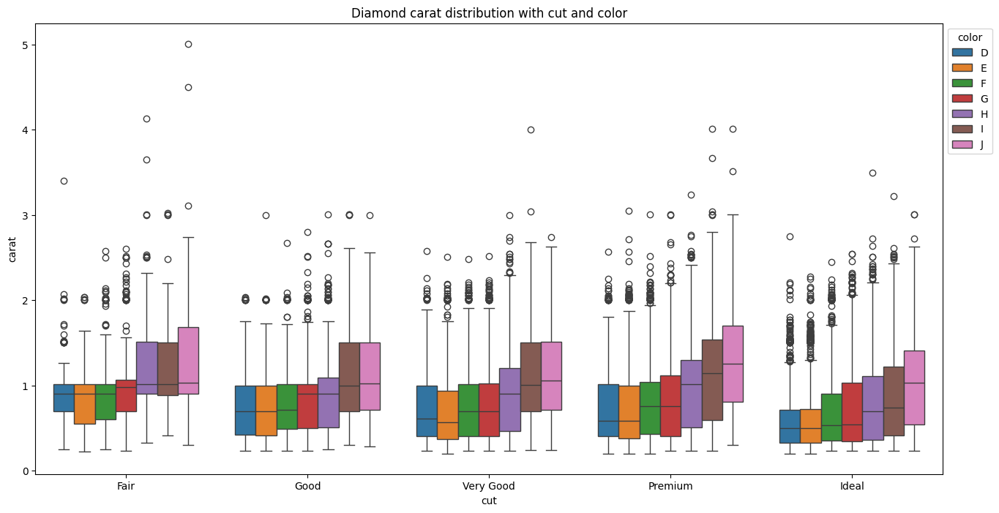

In [4]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=[16,8])
ax = sns.boxplot(data=diamonds, x="cut", hue="color", y="carat")
ax.set_title("Diamond carat distribution with cut and color")
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

- [seaborn.violinplot](https://seaborn.pydata.org/generated/seaborn.violinplot.html)

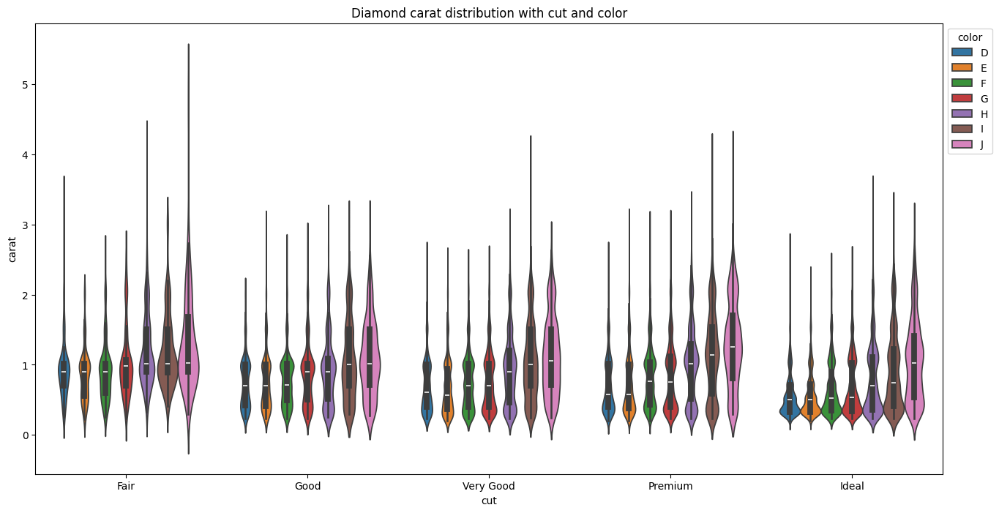

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=[16,8])
ax = sns.violinplot(data=diamonds, x="cut", hue="color", y="carat")
ax.set_title("Diamond carat distribution with cut and color")
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

- [figure size](https://plotnine.org/reference/theme.html#aspect_ratio-and-figure_size)

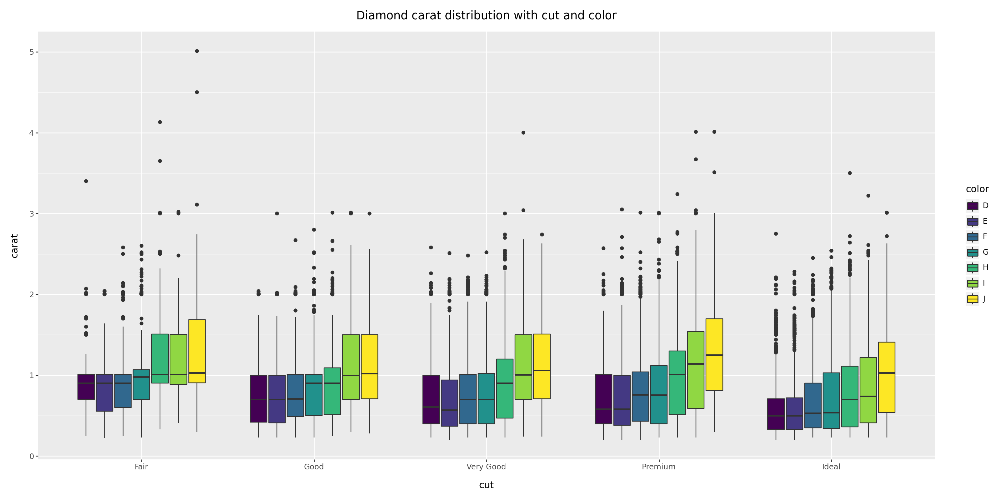

In [6]:
from plotnine import *

g = ggplot(diamonds, aes("cut", "carat", fill="color"))
g += geom_boxplot()
g += ggtitle("Diamond carat distribution with cut and color")
g += theme(figure_size=(16, 8))
g

- [geom_violin](https://plotnine.org/reference/geom_violin.html) 

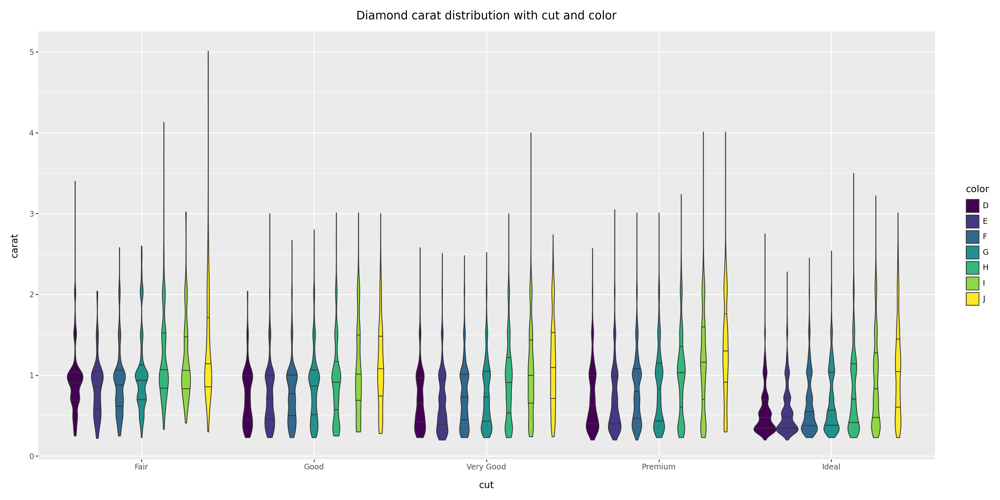

In [7]:
from plotnine import *

g = ggplot(diamonds, aes("cut", "carat", fill="color")) #hue の代わりにfill
g += geom_violin(draw_quantiles=[0.25,0.5,0.75]) #四分位線を指定すると描画されるが、面倒な割にあまり見やすくはない
g += ggtitle("Diamond carat distribution with cut and color")
g += theme(figure_size=(16, 8))
g

- [box plots](https://plotly.com/python/box-plots/)
- [categoryarray](https://plotly.com/python/reference/layout/xaxis/#layout-xaxis-categoryarray)

In [8]:
import plotly.express as px
fig = px.box(diamonds.sort_values(by=["color"]), #凡例の順番は元データをソートするしかないようだ
             x="cut", y="carat", color="color", title="Diamond carat distribution with cut and color")
fig.update_xaxes(categoryarray=["Fair","Good","Very Good","Premium","Ideal"])
fig.show()

In [9]:
import plotly.express as px
fig = px.violin(diamonds.sort_values(by=["color"]), #凡例の順番は元データをソートするしかないようだ
             x="cut", y="carat", color="color", title="Diamond carat distribution with cut and color")
fig.update_xaxes(categoryarray=["Fair","Good","Very Good","Premium","Ideal"])
fig.update_traces(box_visible=True, selector=dict(type='violin'))
fig.show()

- [【Python】データ可視化ライブラリ Altair を使いこなす](https://qiita.com/keisuke-ota/items/aa93f45b3a9fc520541d)
- [5000行を超えるデータにはエラーが出る](https://altair-viz.github.io/user_guide/large_datasets.html) ユーザーに処理の再考をうながすためとのこと
- [他のライブラリでありがちな入れ子のカテゴリは無いのでファセットで対応する](https://stackoverflow.com/questions/66876936/altair-boxplot-with-nested-grouping-by-two-categorical-variables)
- [titleのセンタリングはちょっと手間が必要](https://stackoverflow.com/questions/72694366/configuring-the-title-and-axes-for-an-altair-graph)

In [10]:
import altair as alt
alt.data_transformers.disable_max_rows()

alt.Chart(diamonds).mark_boxplot(extent="min-max").encode(
    x=alt.X("color:O", title=None),
    y=alt.Y("carat:Q").scale(zero=False),
    color="color:N",
    column=alt.Column("cut:N", sort=["Fair","Good","Very Good","Premium","Ideal"], header=alt.Header(orient='bottom'))
).properties(
    title="Diamond carat distribution with cut and color",
    width=200,
    height=300
).configure_facet(
    spacing=20
).configure_view(
    stroke=None
)

alt.Chart(...)

- [Violin Plot](https://altair-viz.github.io/gallery/violin_plot.html)

In [11]:
import altair as alt
alt.data_transformers.disable_max_rows()

alt.Chart(diamonds).transform_density(
    'carat',
    as_=['carat', 'density'],
    extent=[0.0, 5.0],
    groupby=['color']
).mark_area(orient='horizontal').encode(
    alt.X('density:Q')
        .stack('center')
        .impute(None)
        .title(None)
        .axis(labels=False, values=[0], grid=False, ticks=True),
    alt.Y('carat:Q'),
    alt.Color('color:N'),
    alt.Column('color:N')
        .spacing(0)
        .header(titleOrient='bottom', labelOrient='bottom', labelPadding=0)
    # alt.Row("cut:N").spacing(0)
).configure_view(
    stroke=None
)




# mark_boxplot(extent="min-max").encode(
#     x=alt.X("color:O", title=None),
#     y=alt.Y("carat:Q").scale(zero=False),
#     color="color:N",
#     column=alt.Column("cut:N", sort=["Fair","Good","Very Good","Premium","Ideal"], header=alt.Header(orient='bottom'))
# ).properties(
#     title="Diamond carat distribution with cut and color",
#     width=200,
#     height=300
# ).configure_facet(
#     spacing=20
# ).configure_view(
#     stroke=None
# )

alt.Chart(...)